In [1]:
import numpy as np
import pandas as pd
import networkx as nx

import matplotlib.pyplot as plt
import seaborn as sns
sns.reset_orig()

from matplotlib import rc
rc('text', usetex=True)
rc('font', **{'family' : "sans-serif"})
params = {'text.latex.preamble' : [r'\usepackage{siunitx}', r'\usepackage{amsmath}']}
plt.rcParams.update(params)
# https://stackoverflow.com/questions/24350859/latex-font-style-issues-using-amsmath-and-sfmath-for-plot-labeling

from scipy.stats import bernoulli
from scipy.special import loggamma

from sklearn.preprocessing import OneHotEncoder

import tqdm

from rpy2.robjects import numpy2ri
from rpy2.robjects.packages import importr

In [2]:
import os
import pickle

In [3]:
pd.options.display.max_rows = 10000
pd.options.display.max_columns = 1000

In [4]:
from functools import lru_cache

@lru_cache(maxsize = 10000)
def normterm_discrete(n, k):
    if n == 1:
        return np.log(k)
    if k == 1:
        return 1.0
    elif k == 2:
        return np.sum(sorted([ np.exp(loggamma(n+1) - loggamma(t+1) - loggamma(n-t+1) + 
                               t*(np.log(t) - np.log(n)) + (n-t)*(np.log(n-t) - np.log(n))
                        )
                        for t in range(1, n)]))
    else:
        return normterm_discrete(n, k-1) + n/(k-2) * normterm_discrete(n, k-2)

In [5]:
def calc_dnml(X, Z1, Z2, K=3, L=3):    
    N = X.shape[0]
    
    codelen_x_z = 0.0
    codelen_z = 0.0

    for k in range(K):
        for l in range(L):
            n_pos = np.sum(X[Z1 == k, :][:, Z2 == l] == 1)
            n_neg = np.sum(X[Z1 == k, :][:, Z2 == l] == 0)
            n_all = n_pos + n_neg

            if n_all >=2:
                codelen_x_z += n_all * np.log(n_all)
                codelen_x_z += np.log(normterm_discrete(n_all, 2))
                #codelen += n_all * np.log(n_all)
                #codelen += np.log(normterm_discrete(n_all, 2))
            
            if n_pos >=2:
                #codelen -= n_pos * np.log(n_pos)
                codelen_x_z -= n_pos * np.log(n_pos)
            if n_neg >=2:
                #codelen -= n_neg * np.log(n_neg)
                codelen_x_z -= n_neg * np.log(n_neg)
            
            #codelen += codelen_x_z

        n_k = np.sum(Z1 == k)
        if n_k >= 1:
            #codelen += n_k * (np.log(N) - np.log(n_k))
            codelen_z += n_k * (np.log(N) - np.log(n_k))

    #codelen += np.log(normterm_discrete(N, K))
    codelen_z += np.log(normterm_discrete(N, K))
    
    codelen = codelen_x_z + codelen_z

    #return codelen
    return codelen, codelen_x_z, codelen_z

In [6]:
def calc_sc(X, Z1, Z2, K=3, L=3):    
    N = X.shape[0]
    
    sc_x_z = 0.0
    sc_z = 0.0

    for k in range(K):
        for l in range(L):
            n_pos = np.sum(X[Z1 == k, :][:, Z2 == l] == 1)
            n_neg = np.sum(X[Z1 == k, :][:, Z2 == l] == 0)
            n_all = n_pos + n_neg

            if n_all >=2:
                sc_x_z += np.log(normterm_discrete(n_all, 2))

    sc_z += np.log(normterm_discrete(N, K))
    
    return sc_x_z, sc_z

In [7]:
def calc_lsc(X, Z1, Z2, K=3, L=3):    
    codelen = 0.0
    N = X.shape[0]

    for k in range(K):
        for l in range(L):
            n_pos = np.sum(X[Z1 == k, :][:, Z2 == l] == 1)
            n_neg = np.sum(X[Z1 == k, :][:, Z2 == l] == 0)
            n_all = n_pos + n_neg

            if n_all >=2:
                codelen += n_all * np.log(n_all)
            
            if n_pos >=2:
                codelen -= n_pos * np.log(n_pos)
            if n_neg >=2:
                codelen -= n_neg * np.log(n_neg)

        n_k = np.sum(Z1 == k)
        if  n_k >= 1:
            codelen += n_k * (np.log(N) - np.log(n_k))

        codelen += (k + (k+1)*(k+2))/2 * np.log(N/(2.0*np.pi)) -(k+1)/2 * np.log(2.0) + \
           (k+1) * loggamma((k+3)/2) - loggamma((k+1)*(k+3)/2) + (k+1)*(k+2)/2 * np.log(np.pi)

    return codelen

In [8]:
indir = './data'
outdir = './output'
if not os.path.exists(outdir):
    os.makedirs(outdir)

In [9]:
with open(os.path.join(indir, 'X_gradual.pkl'), 'rb') as f:
    X_all = pickle.load(f)

In [10]:
X_all.shape

(10, 100, 100, 100)

In [11]:
with open(os.path.join(outdir, 'pi_gradual.pkl'), 'rb') as f:
    pi_all = pickle.load(f)
with open(os.path.join(outdir, 'theta_gradual.pkl'), 'rb') as f:
    theta_all = pickle.load(f)
with open(os.path.join(outdir, 'z_gradual.pkl'), 'rb') as f:
    z_all = pickle.load(f)

In [12]:
T = X_all.shape[1]
#T = 40
cluster_range_max = 6

In [13]:
from itertools import permutations
import copy

h = 2
M = X_all.shape[0]
T = 100
K = 6

dnml_all = np.nan * np.ones((M, T, K))
dnml_f_all = np.nan * np.ones((M, T, K))
dnml_l_all = np.nan * np.ones((M, T, K))

nml_x_z_all = np.nan * np.ones((M, T, K))
nml_x_z_f_all = np.nan * np.ones((M, T, K))
nml_x_z_l_all = np.nan * np.ones((M, T, K))

nml_z_all = np.nan * np.ones((M, T, K))
nml_z_f_all = np.nan * np.ones((M, T, K))
nml_z_l_all = np.nan * np.ones((M, T, K))

for trial in range(len(z_all)):
#for trial in range(len(z_all)):
    print('trial =', trial)
    for k in range(K):
        print('  k =', k)
        for t in range(h, T-h):
            X_t = X_all[trial, t, :, :]
            
            #phi_hat_all = np.zeros((2*h, k, k))
            nml_x_z_all_list = np.zeros(2*h)
            nml_z_all_list = np.zeros(2*h)
            for j, tau in enumerate(range(t-h+1, t+h+1)):
                #z0 = np.argmax(z_all[trial][t+1][k], axis=1)
                z0 = np.argmax(z_all[trial][tau][k], axis=1)
                n_k1_k2_p = np.array([ [[ np.sum(X_all[trial, t0, z0==k1, :][:, z0==k2] == 1) for k2 in range(k+1)] for k1 in range(k+1)] \
                                       for t0 in range(t-h+1, t+h+1) ])
                n_k1_k2_n = np.array([ [[ np.sum(X_all[trial, t0, z0==k1, :][:, z0==k2] == 0) for k2 in range(k+1)] for k1 in range(k+1)] \
                                       for t0 in range(t-h+1, t+h+1) ])
                n_k1_k2 = n_k1_k2_p + n_k1_k2_n
                phi_hat = np.sum(n_k1_k2_p, axis=0) / np.sum(n_k1_k2, axis=0)
                nml_x_z_all_list[j] = np.sum(-n_k1_k2_p * np.ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) +
                                              np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                   for k2 in range(k+1)] for k1 in range(k+1)] \
                                                 for i, t0 in enumerate(range(t-h+1, t+h+1))]) )

                n_k = np.array([ np.sum(z0==kk) for kk in range(k+1)])
                pi_hat = n_k / np.sum(n_k)
                nml_z_all_list[j] = (np.sum( -n_k * np.ma.log(pi_hat)) + np.ma.log(normterm_discrete(100, k+1)) ) * 2 * h
            #if k == 2:
            #    print('nml_x_z:', nml_x_z_all_list)
            #    print('nml_z:', nml_z_all_list)
            nml_x_z_all[trial, t, k] = np.mean(nml_x_z_all_list)
            nml_z_all[trial, t, k] = np.mean(nml_z_all_list)
            
            #phi_hat = phi_hat.reshape(1, phi_hat.shape[0], phi_hat.shape[1])
            #if k == 2:
            #    print('t =', t)
            #print('phi_hat all:', phi_hat)
            
            """
            nml_x_z_all[trial, t, k] = np.sum(-n_k1_k2_p * np.ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) +
                                              np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                   for k2 in range(k+1)] for k1 in range(k+1)] \
                                                 for i, t0 in enumerate(range(t-h+1, t+h+1))]) )
            
            n_k = np.array([ np.sum(z0==kk) for kk in range(k+1)])
            pi_hat = n_k / np.sum(n_k)
            
            nml_z_all[trial, t, k] = (np.sum( -n_k * np.ma.log(pi_hat)) + np.ma.log(normterm_discrete(100, k+1)) ) * 2 * h
            """
            dnml_all[trial, t, k] = nml_x_z_all[trial, t, k] + nml_z_all[trial, t, k]

            nml_x_z_f_all_list = np.zeros(h)
            nml_z_f_all_list = np.zeros(h)
            for j, tau in enumerate(range(t-h+1, t+1)):
                z1 = np.argmax(z_all[trial][tau][k], axis=1)
                n_k1_k2_p = np.array([ [[ np.sum(X_all[trial, t0, z1==k1, :][:, z1==k2] == 1) for k2 in range(k+1)] for k1 in range(k+1)] \
                                       for t0 in range(t-h+1, t+1) ])
                n_k1_k2_n = np.array([ [[ np.sum(X_all[trial, t0, z1==k1, :][:, z1==k2] == 0) for k2 in range(k+1)] for k1 in range(k+1)] \
                                       for t0 in range(t-h+1, t+1) ])
                n_k1_k2 = n_k1_k2_p + n_k1_k2_n
                #if k == 2:
                #    print(n_k1_k2)
                phi_hat = np.sum(n_k1_k2_p, axis=0) / np.sum(n_k1_k2, axis=0)
                phi_hat = phi_hat.reshape(1, phi_hat.shape[0], phi_hat.shape[1])
                #print('phi_hat former:', phi_hat)
                
                nml_x_z_f_all_list[j] = np.sum(-n_k1_k2_p * np.ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) + 
                                            np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                  for k2 in range(k+1)] for k1 in range(k+1)] \
                                               for i, t0 in enumerate(range(t-h+1, t+1))])
                                        )
                
                n_k = np.array([ np.sum(z1==kk) for kk in range(k+1)])                
                pi_hat = n_k / np.sum(n_k)
                nml_z_f_all_list[j] = (np.sum(-n_k * np.ma.log(pi_hat) ) + np.ma.log(normterm_discrete(100, k+1)) ) * h

            nml_x_z_f_all[trial, t, k] = np.mean(nml_x_z_f_all_list)
            nml_z_f_all[trial, t, k] = np.mean(nml_z_f_all_list)

            #if k == 2:
            #    print('nml_x_z_f:', nml_x_z_f_all_list)
            #    print('nml_z_f:', nml_z_f_all_list)
            
            """
            nml_x_z_f_all[trial, t, k] = np.sum(-n_k1_k2_p * np .ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) + 
                                            np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                  for k2 in range(k+1)] for k1 in range(k+1)] \
                                               for i, t0 in enumerate(range(t-h+1, t+1))])
                                         )
            n_k = np.array([ np.sum(z1 == kk) for kk in range(k+1)])
            #if k == 2:
            #    print(n_k1_k2)
            pi_hat = n_k / np.sum(n_k)
            
            nml_z_f_all[trial, t, k] = (np.sum(-n_k * np.ma.log(pi_hat) ) + np.ma.log(normterm_discrete(100, k+1)) ) * h
            """
            dnml_f_all[trial, t, k] = nml_x_z_f_all[trial, t, k] + nml_z_f_all[trial, t, k]
            
            nml_x_z_l_all_list = np.zeros(h)
            nml_z_l_all_list = np.zeros(h)
            for j, tau in enumerate(range(t+1, t+h+1)):
                z2 = np.argmax(z_all[trial][tau][k], axis=1)
                n_k1_k2_p = np.array([ [[ np.sum(X_all[trial, t0, z2==k1, :][:, z2==k2] == 1) for k2 in range(k+1)] for k1 in range(k+1)] \
                                      for t0 in range(t+1, t+h+1)])
                n_k1_k2_n = np.array([ [[ np.sum(X_all[trial, t0, z2==k1, :][:, z2==k2] == 0) for k2 in range(k+1)] for k1 in range(k+1)] \
                                      for t0 in range(t+1, t+h+1)])
                n_k1_k2 = n_k1_k2_p + n_k1_k2_n
  
                phi_hat = np.sum(n_k1_k2_p, axis=0) / np.sum(n_k1_k2, axis=0)
                phi_hat = phi_hat.reshape(1, phi_hat.shape[0], phi_hat.shape[1])
            
                nml_x_z_l_all_list[j] = np.sum(-n_k1_k2_p * np.ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) + \
                                            np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                        for k2 in range(k+1)] for k1 in range(k+1)] \
                                                      for i, t0 in enumerate(range(t+1, t+h+1))])
                                        )
            
                n_k = np.array([ np.sum(z2==kk) for kk in range(k+1)])
                pi_hat = n_k / np.sum(n_k)
                
                nml_z_l_all_list[j] = (np.sum(-n_k * np.ma.log(pi_hat) ) + np.ma.log(normterm_discrete(100, k+1)) ) * h
                

            """
            nml_x_z_l_all[trial, t, k] = np.sum(-n_k1_k2_p * np.ma.log(phi_hat) - n_k1_k2_n * np.ma.log(1.0 - phi_hat) + \
                                            np.array([[[ np.ma.log(normterm_discrete(n_k1_k2[i, k1, k2], 2)) \
                                                        for k2 in range(k+1)] for k1 in range(k+1)] \
                                                      for i, t0 in enumerate(range(t+1, t+h+1))])
                                         )
            
            nml_z_l_all[trial, t, k] = (np.sum(-n_k * np.ma.log(pi_hat) ) + np.ma.log(normterm_discrete(100, k+1)) ) * h
            """
            nml_x_z_l_all[trial, t, k] = np.mean(nml_x_z_l_all_list)
            nml_z_l_all[trial, t, k] = np.mean(nml_z_l_all_list)
            
            #if k == 2:
            #    print('nml_x_z_l:', nml_x_z_l_all_list)
            #    print('nml_z_l:', nml_z_l_all_list)
            
            
            dnml_l_all[trial, t, k] = nml_x_z_l_all[trial, t, k] + nml_z_l_all[trial, t, k]
            
            #if k == 2:
            #    print('nml_x_z:', nml_x_z_all[trial, t, k], nml_x_z_f_all[trial, t, k], nml_x_z_l_all[trial, t, k])
            #    print('nml_z:', nml_z_all[trial, t, k], nml_z_f_all[trial, t, k], nml_z_l_all[trial, t, k])
            #    print('')


trial = 0
  k = 0
  k = 1
  k = 2
  k = 3
  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in true_divide
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-

  k = 5


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

trial = 1
  k = 0
  k = 1
  k = 2
  k = 3


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 5


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

trial = 2
  k = 0
  k = 1
  k = 2
  k = 3
  k = 4
  k = 5
trial = 3
  k = 0
  k = 1
  k = 2
  k = 3


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 5


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-f

trial = 4
  k = 0
  k = 1
  k = 2
  k = 3


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 4
  k = 5
trial = 5
  k = 0
  k = 1
  k = 2
  k = 3
  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 5


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

trial = 6
  k = 0
  k = 1
  k = 2
  k = 3


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 5


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

trial = 7
  k = 0
  k = 1
  k = 2
  k = 3


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 4


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

  k = 5


/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Warning: converting a masked element to nan.
/Users/shi

trial = 8
  k = 0
  k = 1
  k = 2
  k = 3
  k = 4
  k = 5
trial = 9
  k = 0
  k = 1
  k = 2
  k = 3
  k = 4
  k = 5


In [14]:
def codelen_integer(k):
    codelen = np.log(2.865)
    while k >= 0.0:
        codelen += k
        k = np.log(k)
        
    return codelen

In [19]:
def calc_stats(X, z, scores, scores_f, scores_l, h, delta):
    scores = np.array(scores)
    scores_f = np.array(scores_f)
    scores_l = np.array(scores_l)
    
    K = scores.shape[2]
    N_trial = scores.shape[0]
    T = scores.shape[1]
    
    codelens = np.array([ codelen_integer(k) for k in range(1, K+1)])
    
    idxes_all = np.argmin(scores + np.tile(codelens[np.newaxis, np.newaxis], (N_trial, T, 1))[0, 0, :], axis=2)
    
    models_estimated = np.zeros((N_trial, T), dtype=np.int)
    models_former = np.zeros((N_trial, T), dtype=np.int)
    models_latter = np.zeros((N_trial, T), dtype=np.int)
    stats_complete = np.zeros((N_trial, T))
    
    for trial in range(scores.shape[0]):
        print('trial =', trial)
        n_change = 0  # number of changes so far.
        for t in range(T):
            alpha= (n_change+1/2) / (t+1+1)
            m_estimated = idxes_all[trial, t]

            # Lv.3 change (Model change)
            stats_half_t = np.zeros((cluster_range_max, cluster_range_max), dtype=np.float)
            for k1 in range(cluster_range_max):
                stats_former = scores_f[trial, t, k1]
                for k2 in range(cluster_range_max):
                    if k1 == k2:
                        p = 1.0 - alpha
                    else:
                        p = alpha/(K-1)
                    stats_latter = scores_l[trial, t, k2]
                    stats_half_t[k1, k2] = stats_former + stats_latter + codelens[k1] - np.log(p)
            m_former_estimated, m_latter_estimated = np.unravel_index(np.nanargmin(stats_half_t), (cluster_range_max, cluster_range_max))
            models_former[trial, t] = m_former_estimated
            models_latter[trial, t] = m_latter_estimated
            
            stat = 0.5 / h *(scores[trial, t, m_estimated] + codelens[m_estimated] - stats_half_t[m_former_estimated, m_latter_estimated])
            stats_complete[trial, t] = stat
            
            X_t = X[trial, t, :, :]
            z_t = np.argmax(z[trial][t][m_estimated], axis=1)
            sc_x_z, sc_z = calc_sc(X_t, z_t, m_estimated+1, m_estimated+1)
            thr_M = (sc_x_z + sc_z + codelens[m_estimated] - delta) / (2.0 * h)
            
            if (m_estimated == m_latter_estimated):
                # no model change happened
                model_t = m_estimated
            else:
                model_t = m_latter_estimated
        
            if t >= 1:
                model_prev = models_estimated[trial, t-1]
                if model_t != model_prev:
                    n_change += 1            
            models_estimated[trial, t] = model_t
    
        #print('trial =', trial, 'n_change =', n_change)
    
    stats_complete = np.hstack(([[np.nan]*2*h]*stats_complete.shape[0], stats_complete))

    return stats_complete, models_estimated, models_former, models_latter

In [20]:
def calc_stats_with_modelidx(scores, scores_f, scores_l, idxes_model, idxes_model_f, idxes_model_l, h):
    scores = np.array(scores)
    scores_f = np.array(scores_f)
    scores_l = np.array(scores_l)
    
    stats_complete = np.zeros((idxes_model.shape[0], idxes_model.shape[1]), dtype=np.float)
    for trial in range(idxes_model.shape[0]):
        for t in range(idxes_model.shape[1]):
            stat = 0.5/h * (scores[trial, t, idxes_model[trial, t]] - \
                            scores_f[trial, t, idxes_model_f[trial, t]] - \
                            scores_l[trial, t, idxes_model_l[trial, t]])
            stats_complete[trial, t] = stat
            
    stats_complete = np.hstack(([[np.nan]*2*h]*stats_complete.shape[0], stats_complete))
            
    return stats_complete

In [21]:
np.set_printoptions(threshold=10000)

In [22]:
delta = 0.01

dnml, models_estimated, models_former, models_latter = calc_stats(
    X_all, z_all, dnml_all[:len(z_all), h:(T-h), :], dnml_f_all[:len(z_all), h:(T-h), :], dnml_l_all[:len(z_all), h:(T-h), :], h, delta=delta)

nml_x_z = calc_stats_with_modelidx(nml_x_z_all[:len(z_all), h:(T-h), :], nml_x_z_f_all[:len(z_all), h:(T-h), :], nml_x_z_l_all[:len(z_all), h:(T-h), :], 
                                   models_estimated, models_former, models_latter, h)
 
nml_z = calc_stats_with_modelidx(nml_z_all[:len(z_all), h:(T-h), :], nml_z_f_all[:len(z_all), h:(T-h), :], nml_z_l_all[:len(z_all), h:(T-h), :], 
                                 models_estimated, models_former, models_latter, h)

/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """


trial = 0
trial = 1
trial = 2
trial = 3
trial = 4
trial = 5
trial = 6
trial = 7
trial = 8
trial = 9


In [23]:
dnml_df = pd.DataFrame(dnml, columns=np.arange(1, T+1).astype(str)).reset_index()
nml_x_z_df = pd.DataFrame(nml_x_z, columns=np.arange(1, T+1).astype(str)).reset_index()
nml_z_df = pd.DataFrame(nml_z, columns=np.arange(1, T+1).astype(str)).reset_index()

In [24]:
dnml_df_melt = dnml_df.melt(id_vars='index')
dnml_df_melt['variable'] = dnml_df_melt['variable'].astype(int)

nml_x_z_df_melt = nml_x_z_df.melt(id_vars='index')
nml_x_z_df_melt['variable'] = nml_x_z_df_melt['variable'].astype(int)

nml_z_df_melt = nml_z_df.melt(id_vars='index')
nml_z_df_melt['variable'] = nml_z_df_melt['variable'].astype(int)

In [25]:
dnml_df_melt['criterion'] = 'DNML'
nml_x_z_df_melt['criterion'] = 'NML (X|Z)'
nml_z_df_melt['criterion'] = 'NML (Z)'

In [26]:
nml_x_z_df_melt.head(3)

,index,variable,value,criterion
0,0,1,NaN,NML (X|Z)
1,1,1,NaN,NML (X|Z)
2,2,1,NaN,NML (X|Z)


In [27]:
models_estimated.shape

(10, 96)

In [28]:
models_estimated_df_melt = pd.DataFrame(models_estimated+1, columns=np.arange(2*h+1, T+1).astype(int)).melt()

/Users/shi-fukushima/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


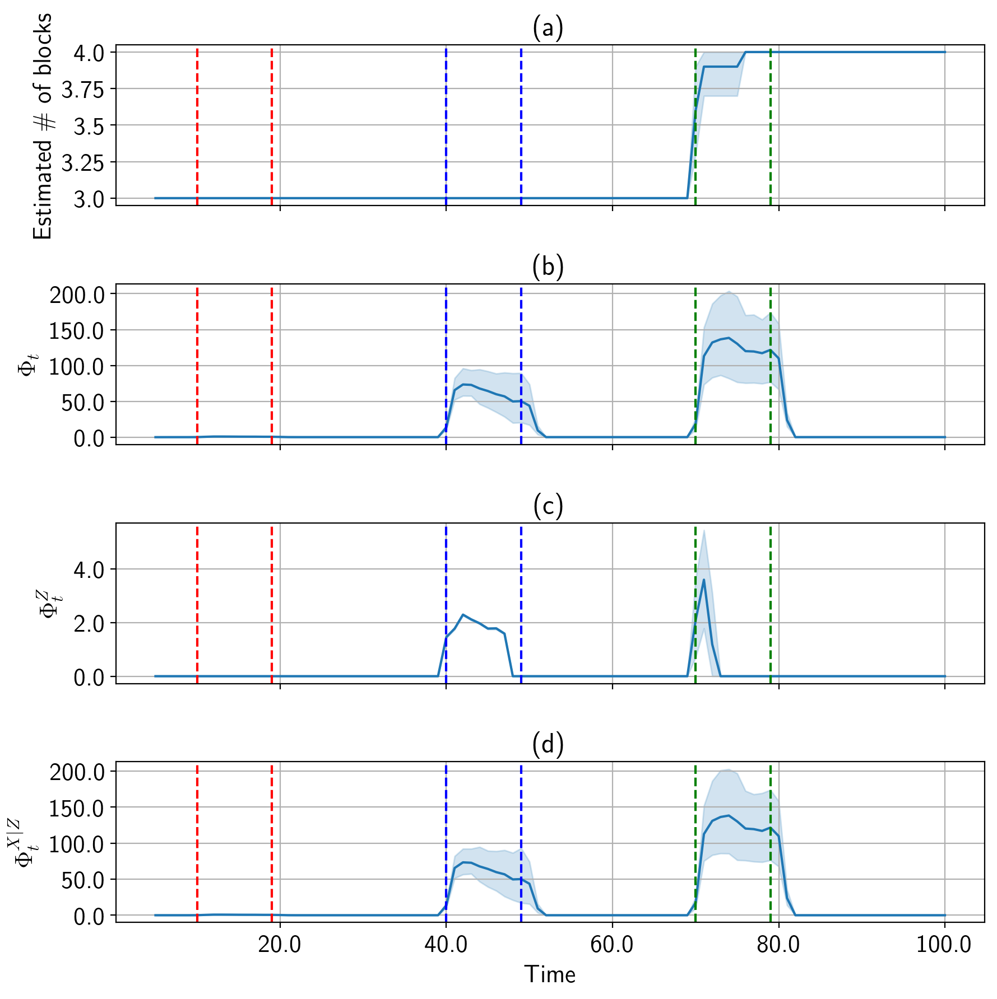

In [36]:
fontsize_title = 18
fontsize = 16

fig, axes = plt.subplots(4, 1, sharex=True, figsize=(9, 9), dpi=200)

sns.lineplot(x='variable', y='value', data=models_estimated_df_melt, ax=axes[0])
axes[0].axvline(x=10, color='red', linestyle='dashed')
axes[0].axvline(x=19, color='red', linestyle='dashed')
axes[0].axvline(x=40, color='blue', linestyle='dashed')
axes[0].axvline(x=49, color='blue', linestyle='dashed')
axes[0].axvline(x=70, color='green', linestyle='dashed')
axes[0].axvline(x=79, color='green', linestyle='dashed')
axes[0].grid()
axes[0].set_title('(a)', fontsize=fontsize_title)
axes[0].set_xlabel('Time', fontsize=fontsize)
axes[0].set_ylabel('Estimated \# of blocks', fontsize=fontsize)

sns.lineplot(x='variable', y='value', data=dnml_df_melt, ax=axes[1])
axes[1].axvline(x=10, color='red', linestyle='dashed')
axes[1].axvline(x=19, color='red', linestyle='dashed')
axes[1].axvline(x=40, color='blue', linestyle='dashed')
axes[1].axvline(x=49, color='blue', linestyle='dashed')
axes[1].axvline(x=70, color='green', linestyle='dashed')
axes[1].axvline(x=79, color='green', linestyle='dashed')
axes[1].grid()
axes[1].set_title('(b)', fontsize=fontsize_title)
axes[1].set_xlabel('Time', fontsize=fontsize)
axes[1].set_ylabel(r'$\Phi_{t}$', fontsize=fontsize, rotation=90)

sns.lineplot(x='variable', y='value', data=nml_z_df_melt, ax=axes[2])
axes[2].axvline(x=10, color='red', linestyle='dashed')
axes[2].axvline(x=19, color='red', linestyle='dashed')
axes[2].axvline(x=40, color='blue', linestyle='dashed')
axes[2].axvline(x=49, color='blue', linestyle='dashed')
axes[2].axvline(x=70, color='green', linestyle='dashed')
axes[2].axvline(x=79, color='green', linestyle='dashed')
axes[2].grid()
axes[2].set_title('(c)', fontsize=fontsize_title)
axes[2].set_xlabel('Time', fontsize=fontsize)
axes[2].set_ylabel(r'$\Phi_{t}^{Z}$', fontsize=fontsize)

sns.lineplot(x='variable', y='value', data=nml_x_z_df_melt, ax=axes[3])
axes[3].axvline(x=10, color='red', linestyle='dashed')
axes[3].axvline(x=19, color='red', linestyle='dashed')
axes[3].axvline(x=40, color='blue', linestyle='dashed')
axes[3].axvline(x=49, color='blue', linestyle='dashed')
axes[3].axvline(x=70, color='green', linestyle='dashed')
axes[3].axvline(x=79, color='green', linestyle='dashed')
axes[3].grid()
axes[3].set_title('(d)', fontsize=fontsize_title)
axes[3].set_xlabel('Time', fontsize=fontsize)
axes[3].set_ylabel(r'$\Phi_{t}^{X|Z}$', fontsize=fontsize)

for ax in axes:
    fontProperties = {'family':'sans-serif', 'weight': 'normal', 'size': fontsize}
    ax.set_xticklabels(ax.get_xticks(), fontProperties)
    ax.set_yticklabels(ax.get_yticks(), fontProperties)

fig.tight_layout()

plt.show()